In [61]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go
import seaborn as sns
import pandas as pd
import plotly.express as px
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.utils.validation import check_is_fitted

In [62]:
df = pd.read_csv("../bueros data/bsas_realstate_on_sale_properati_dataset_2020.csv")

In [63]:
df.head()

,start_date,end_date,created_on,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,title,description,property_type,operation_type
0,2019-10-17,2019-12-23,2019-10-17,-34.605880,-58.384949,Argentina,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,USD,"***Venta semipiso centro, ideal hostel*****",DESCRIPCION DE LA PROPIEDAD: Departamento de 1...,Departamento,Venta
1,2019-10-17,2019-11-21,2019-10-17,-34.624056,-58.412110,Argentina,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,USD,Espectacular PH reciclado en Boedo sin expensas.,PH reciclado en Boedo a una cuadra de la plaz...,PH,Venta
2,2019-10-17,2019-11-01,2019-10-17,-34.593569,-58.427474,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Pal...,"2 ambienets amplio , excelente estado , patio ...",PH,Venta
3,2019-10-17,2019-12-23,2019-10-17,-34.581294,-58.436754,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,USD,COSTA RICA 5800 / PALERMO HOLLYWOOD / VENTA PH...,HERMOSO PH EN PALERMO!!!2 AMBIENTES TOTALMENTE...,PH,Venta
4,2019-10-17,2020-03-11,2019-10-17,-34.914194,-57.938219,Argentina,Bs.As. G.B.A. Zona Sur,La Plata,2.0,1.0,1.0,50.0,35.0,40000.0,USD,58 entre 1 y 2 Venta de departamento en ph.1 ...,58 entre 1 y 2 Venta de departamento en PH. P...,PH,Venta


In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 146660 entries, 0 to 146659
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   start_date       146660 non-null  object 
 1   end_date         146660 non-null  object 
 2   created_on       146660 non-null  object 
 3   lat              136735 non-null  float64
 4   lon              136701 non-null  float64
 5   l1               146660 non-null  object 
 6   l2               146660 non-null  object 
 7   l3               146660 non-null  object 
 8   rooms            146660 non-null  float64
 9   bedrooms         146660 non-null  float64
 10  bathrooms        140703 non-null  float64
 11  surface_total    126133 non-null  float64
 12  surface_covered  125046 non-null  float64
 13  price            146660 non-null  float64
 14  currency         146660 non-null  object 
 15  title            146660 non-null  object 
 16  description      146660 non-null  obje

In [65]:
df.isnull().sum()

start_date             0
end_date               0
created_on             0
lat                 9925
lon                 9959
l1                     0
l2                     0
l3                     0
rooms                  0
bedrooms               0
bathrooms           5957
surface_total      20527
surface_covered    21614
price                  0
currency               0
title                  0
description            0
property_type          0
operation_type         0
dtype: int64

In [66]:
# df = df.drop(columns = ["bathrooms", "surface_covered"])

In [67]:
df.isnull().sum()

start_date             0
end_date               0
created_on             0
lat                 9925
lon                 9959
l1                     0
l2                     0
l3                     0
rooms                  0
bedrooms               0
bathrooms           5957
surface_total      20527
surface_covered    21614
price                  0
currency               0
title                  0
description            0
property_type          0
operation_type         0
dtype: int64

In [68]:
df = df.dropna()

In [69]:
df.isnull().sum()

start_date         0
end_date           0
created_on         0
lat                0
lon                0
l1                 0
l2                 0
l3                 0
rooms              0
bedrooms           0
bathrooms          0
surface_total      0
surface_covered    0
price              0
currency           0
title              0
description        0
property_type      0
operation_type     0
dtype: int64

In [70]:
df = df.rename(columns = {"l1": "country", "l2":"state", "l3":"district"})

In [71]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 114488 entries, 0 to 146659
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   start_date       114488 non-null  object 
 1   end_date         114488 non-null  object 
 2   created_on       114488 non-null  object 
 3   lat              114488 non-null  float64
 4   lon              114488 non-null  float64
 5   country          114488 non-null  object 
 6   state            114488 non-null  object 
 7   district         114488 non-null  object 
 8   rooms            114488 non-null  float64
 9   bedrooms         114488 non-null  float64
 10  bathrooms        114488 non-null  float64
 11  surface_total    114488 non-null  float64
 12  surface_covered  114488 non-null  float64
 13  price            114488 non-null  float64
 14  currency         114488 non-null  object 
 15  title            114488 non-null  object 
 16  description      114488 non-null  obje

<AxesSubplot:>

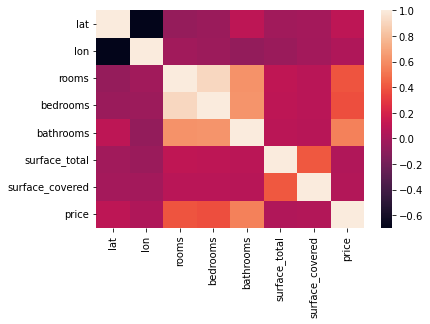

In [72]:
sns.heatmap(df.corr())

In [73]:
fig = px.scatter_mapbox(
    df,
    lat = 'lat',
    lon = 'lon',
    center={"lat": -34.603722, "lon": -58.381592},  # Map will be centered on Buenos Aires
    width=600,  # Width of map
    height=600,  # Height of map
    hover_data=["price"],)


fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [74]:
df.describe()

,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,114488.000000,114488.000000,114488.000000,114488.000000,114488.000000,114488.000000,114488.000000,1.144880e+05
mean,-34.598315,-58.462856,3.130538,2.067413,1.571527,190.794642,111.777697,2.384234e+05
std,0.095430,0.140075,1.399169,1.088154,0.863424,1485.207096,904.398576,2.947070e+05
min,-35.150806,-59.042416,1.000000,0.000000,1.000000,10.000000,1.000000,6.000000e+03
25%,-34.620238,-58.499527,2.000000,1.000000,1.000000,52.000000,46.000000,1.150000e+05
50%,-34.598219,-58.443019,3.000000,2.000000,1.000000,78.000000,67.000000,1.680000e+05
75%,-34.571633,-58.410219,4.000000,3.000000,2.000000,137.000000,107.000000,2.640000e+05
max,-34.159732,-57.805832,35.000000,15.000000,14.000000,169000.000000,126062.000000,3.243423e+07


Text(0, 0.5, 'Price')

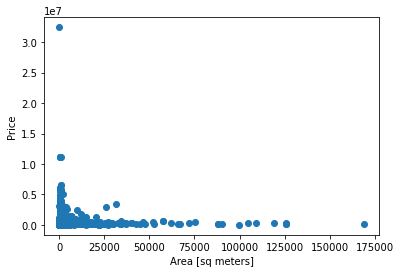

In [75]:
plt.scatter(df["surface_total"], df["price"])
plt.xlabel("Area [sq meters]")
plt.ylabel("Price")

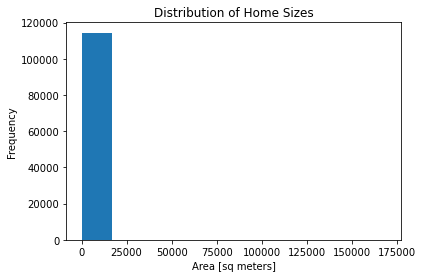

In [76]:
plt.hist(df["surface_total"])
plt.xlabel("Area [sq meters]")
plt.ylabel("Frequency")
plt.title("Distribution of Home Sizes");

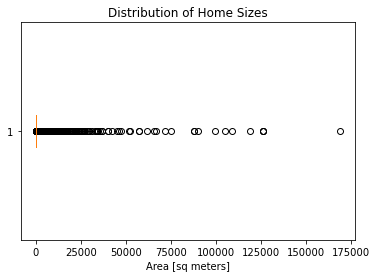

In [77]:
plt.boxplot(df["surface_total"], vert = False)
plt.title("Distribution of Home Sizes")
plt.xlabel("Area [sq meters]");

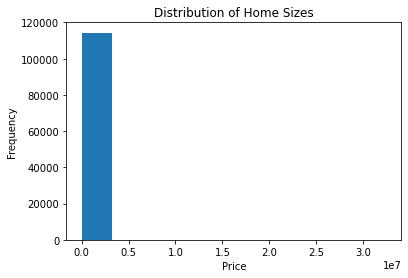

In [78]:
plt.hist(df["price"])
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.title("Distribution of Home Sizes");

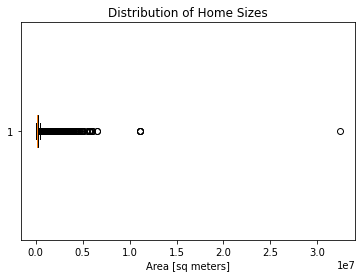

In [79]:
plt.boxplot(df["price"], vert = False)
plt.title("Distribution of Home Sizes")
plt.xlabel("Area [sq meters]");

# Time To remove Outliers

In [80]:
# low_1, high_1 = df["surface_total"].quantile([0.10, 0.90])
# mask_area = df["surface_total"].between(low_1, high_1)
mask_area = df["surface_total"] < df["surface_total"].quantile([0.90]).max()

In [81]:
# low_2, high_2 = df["price"].quantile([0.10, 0.90])
mask_price = df["price"] < df["price"].quantile([0.90]).max()

In [82]:
mask_capital = df["state"] == "Capital Federal"

In [83]:
df = df[mask_area & mask_price & mask_capital]
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 67468 entries, 0 to 146549
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   start_date       67468 non-null  object 
 1   end_date         67468 non-null  object 
 2   created_on       67468 non-null  object 
 3   lat              67468 non-null  float64
 4   lon              67468 non-null  float64
 5   country          67468 non-null  object 
 6   state            67468 non-null  object 
 7   district         67468 non-null  object 
 8   rooms            67468 non-null  float64
 9   bedrooms         67468 non-null  float64
 10  bathrooms        67468 non-null  float64
 11  surface_total    67468 non-null  float64
 12  surface_covered  67468 non-null  float64
 13  price            67468 non-null  float64
 14  currency         67468 non-null  object 
 15  title            67468 non-null  object 
 16  description      67468 non-null  object 
 17  property_ty

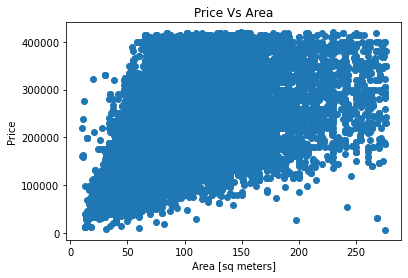

In [84]:
plt.scatter(df["surface_total"], df["price"])
plt.xlabel("Area [sq meters]")
plt.ylabel("Price")
plt.title("Price Vs Area");

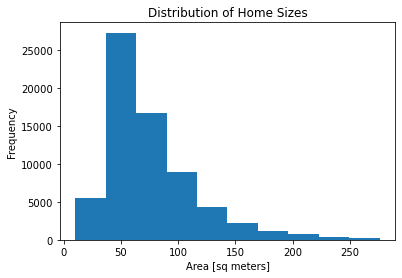

In [85]:
plt.hist(df["surface_total"])
plt.xlabel("Area [sq meters]")
plt.ylabel("Frequency")
plt.title("Distribution of Home Sizes");

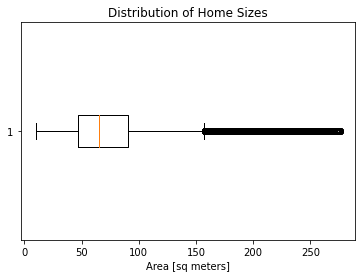

In [86]:
plt.boxplot(df["surface_total"], vert = False)
plt.title("Distribution of Home Sizes")
plt.xlabel("Area [sq meters]");

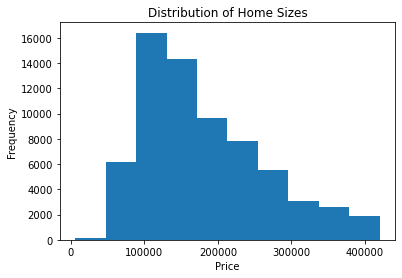

In [87]:
plt.hist(df["price"])
plt.xlabel("Price")
plt.ylabel("Frequency")
plt.title("Distribution of Home Sizes");

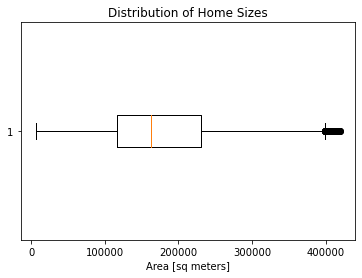

In [88]:
plt.boxplot(df["price"], vert = False)
plt.title("Distribution of Home Sizes")
plt.xlabel("Area [sq meters]");

In [89]:
df["state"].value_counts()

Capital Federal    67468
Name: state, dtype: int64

In [90]:
df["district"].value_counts().head()

Palermo         8969
Almagro         6527
Villa Crespo    5722
Caballito       5137
Belgrano        4061
Name: district, dtype: int64

In [91]:
mean_price_by_state = df.groupby("state")["price"].mean().sort_values(ascending = False)
mean_price_by_state.head()

state
Capital Federal    181153.380403
Name: price, dtype: float64

<AxesSubplot:title={'center':'Mean House By State'}, xlabel='State', ylabel='Price [USD]'>

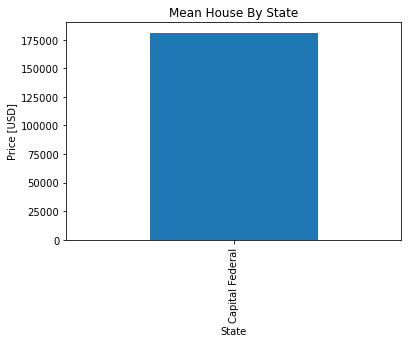

In [92]:
mean_price_by_state.plot(
kind = "bar",
xlabel = "State",
ylabel = "Price [USD]",
title = "Mean House By State")

In [93]:
mean_price_by_district = df.groupby("district")["price"].mean().sort_values(ascending = False)
mean_price_by_district.head()

district
Puerto Madero    309542.810714
Las Cañitas      234011.670423
Recoleta         231998.664325
Belgrano         222611.249446
Barrio Norte     214673.256649
Name: price, dtype: float64

<AxesSubplot:title={'center':'Mean House By State'}, xlabel='District', ylabel='Price [USD]'>

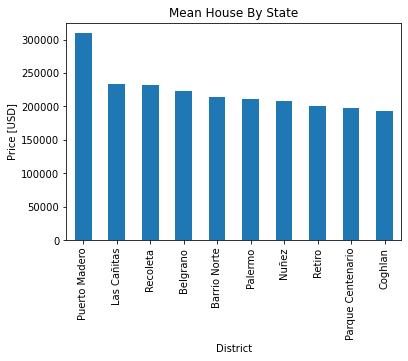

In [94]:
mean_price_by_district.head(10).plot(
kind = "bar",
xlabel = "District",
ylabel = "Price [USD]",
title = "Mean House By State")

In [95]:
df["price_per_m2"] = df["price"] / df["surface_total"]

In [96]:
mean_ppa_by_state = df.groupby("state")["price_per_m2"].mean().sort_values(ascending = False)
mean_ppa_by_state

state
Capital Federal    2567.122214
Name: price_per_m2, dtype: float64

In [97]:
mean_ppa_by_district = df.groupby("district")["price_per_m2"].mean().sort_values(ascending = False)
mean_ppa_by_district.head()

district
Puerto Madero    4956.276897
Las Cañitas      3387.036676
Recoleta         3155.517391
Palermo          3150.893471
Belgrano         3143.876890
Name: price_per_m2, dtype: float64

In [98]:
df.head()

,start_date,end_date,created_on,lat,lon,country,state,district,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,title,description,property_type,operation_type,price_per_m2
0,2019-10-17,2019-12-23,2019-10-17,-34.605880,-58.384949,Argentina,Capital Federal,San Cristobal,7.0,7.0,2.0,140.0,140.0,153000.0,USD,"***Venta semipiso centro, ideal hostel*****",DESCRIPCION DE LA PROPIEDAD: Departamento de 1...,Departamento,Venta,1092.857143
1,2019-10-17,2019-11-21,2019-10-17,-34.624056,-58.412110,Argentina,Capital Federal,Boedo,2.0,1.0,2.0,70.0,58.0,159000.0,USD,Espectacular PH reciclado en Boedo sin expensas.,PH reciclado en Boedo a una cuadra de la plaz...,PH,Venta,2271.428571
2,2019-10-17,2019-11-01,2019-10-17,-34.593569,-58.427474,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,45.0,45.0,125000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Pal...,"2 ambienets amplio , excelente estado , patio ...",PH,Venta,2777.777778
3,2019-10-17,2019-12-23,2019-10-17,-34.581294,-58.436754,Argentina,Capital Federal,Palermo,2.0,1.0,1.0,85.0,50.0,295000.0,USD,COSTA RICA 5800 / PALERMO HOLLYWOOD / VENTA PH...,HERMOSO PH EN PALERMO!!!2 AMBIENTES TOTALMENTE...,PH,Venta,3470.588235
5,2019-10-17,2019-11-01,2019-10-17,-34.593779,-58.441239,Argentina,Capital Federal,Villa Crespo,2.0,1.0,1.0,56.0,56.0,150000.0,USD,Depto.tipo casa de 2 ambientes en Venta en Vil...,"Excelente ph solo 2 unidades, no paga expensas...",PH,Venta,2678.571429


# Price and Size

In [99]:
features = ["surface_total"] #feature matrix must always be 2 dimensional
X_train_size = df[features]
X_train_size.shape

(67468, 1)

In [100]:
target = "price"
y_train_size = df[target]
y_train_size.shape

(67468,)

## Baseline Model

In [101]:
y_mean_size = y_train_size.mean()
y_mean_size

181153.38040256122

In [102]:
y_pred_baseline_size = [y_mean_size] * len(y_train_size)

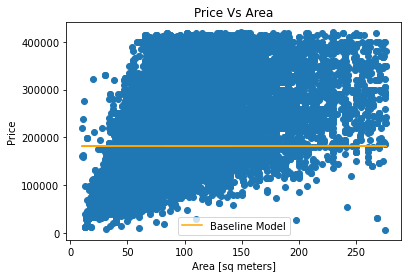

In [103]:
plt.plot(X_train_size, y_pred_baseline_size, color = 'orange', label = "Baseline Model")
plt.scatter(X_train_size, y_train_size)
plt.xlabel("Area [sq meters]")
plt.ylabel("Price")
plt.title("Price Vs Area")
plt.legend();

In [104]:
mae_baseline_size = mean_absolute_error(y_train_size, y_pred_baseline_size)

print("Mean House Price:", round(y_mean_size, 2))
print("Mean Absolute Error:", round(mae_baseline_size, 2))

Mean House Price: 181153.38
Mean Absolute Error: 67272.55


This value tells us that our model needs to have mean absolute error below $67,272.55 in order to be useful. Now we iterate

In [105]:
model = LinearRegression()

In [106]:
model.fit(X_train_size, y_train_size)

LinearRegression()

In [107]:
y_pred_training_size = model.predict(X_train_size)

In [108]:
mae_training_size = mean_absolute_error(y_train_size, y_pred_training_size)

print("Mean House Price:", round(y_mean_size, 2))
print("Mean Absolute Error:", round(mae_training_size, 2))

Mean House Price: 181153.38
Mean Absolute Error: 44164.41


Our model beat the baseline by over $23,000! That's a good indicator that it will be helpful in predicting apartment prices.

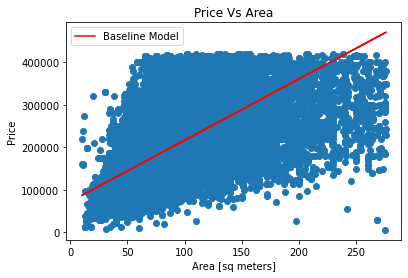

In [109]:
plt.plot(X_train_size, y_pred_training_size, color = 'r', label = "Baseline Model")
plt.scatter(X_train_size, y_train_size)
plt.xlabel("Area [sq meters]")
plt.ylabel("Price")
plt.title("Price Vs Area")
plt.legend();

# Price and Location

In [110]:
fig = px.scatter_mapbox(
    df,  # Our DataFrame
    lat= "lat",
    lon= "lon",
    width=600,  # Width of map
    height=600,  # Height of map
    color= "price",
    hover_data=["price"],  # Display price when hovering mouse over house
)

fig.update_layout(mapbox_style="open-street-map")

fig.show()

In [111]:
# Create 3D scatter plot
fig = px.scatter_3d(
    df,
    x= "lat",
    y= "lon",
    z= "price",
    labels={"lon": "longitude", "lat": "latitude", "price_aprox_usd": "price"},
    width=600,
    height=500,
)

# Refine formatting
fig.update_traces(
    marker={"size": 4, "line": {"width": 2, "color": "DarkSlateGrey"}},
    selector={"mode": "markers"},
)

# Display figure
fig.show()

In [112]:
features_loc = ["lat", "lon"]
X_train_loc = df[features_loc]
X_train_loc.shape

(67468, 2)

In [113]:
target_loc = "price"
y_train_loc = df[target_loc]
y_train_loc.shape

(67468,)

## Baseline Model

In [114]:
y_mean_loc = y_train_loc.mean()
y_mean_loc

181153.38040256122

In [115]:
y_pred_baseline_loc = len(y_train_loc) * [y_mean_loc]
y_pred_baseline_loc[:5]

[181153.38040256122,
 181153.38040256122,
 181153.38040256122,
 181153.38040256122,
 181153.38040256122]

In [116]:
model2 = LinearRegression()

In [117]:
model2.fit(X_train_loc, y_train_loc)

LinearRegression()

In [118]:
y_pred_training_loc = model2.predict(X_train_loc)

In [119]:
mae_training_loc = mean_absolute_error(y_train_loc, y_pred_training_loc)

print("Mean Absolute Error:", round(mae_training_loc,2))

Mean Absolute Error: 64964.75


It looks like our model performs a little better than the baseline. This suggests that latitude and longitude aren't as strong predictors of price as size is.

# Price and Neigboorhood